# Bangalore House Price Prediction - Machine Learning

## Import Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
sns.set_style('whitegrid')

## Load dataset

In [2]:
df_raw = pd.read_csv('Bengaluru_House_Data.csv')
df_raw.head()

,area_type,availability,location,size,society,total_sqft,bath,balcony,price
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,Coomee,1056,2.0,1.0,39.07
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,Theanmp,2600,5.0,3.0,120.00
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,NaN,1440,2.0,3.0,62.00
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,Soiewre,1521,3.0,1.0,95.00
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,NaN,1200,2.0,1.0,51.00


In [3]:
df_raw.shape

(13320, 9)

## Exploratory Data Analysis

In [4]:
df = df_raw.copy()

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13320 entries, 0 to 13319
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   area_type     13320 non-null  object 
 1   availability  13320 non-null  object 
 2   location      13319 non-null  object 
 3   size          13304 non-null  object 
 4   society       7818 non-null   object 
 5   total_sqft    13320 non-null  object 
 6   bath          13247 non-null  float64
 7   balcony       12711 non-null  float64
 8   price         13320 non-null  float64
dtypes: float64(3), object(6)
memory usage: 936.7+ KB


#### We have only 3 neumerical features - bath, balcony and price
#### 6 categorical features - area type, availability, size, society, and total_srft
#### Target Feature =======>>>>>> price >>>>>>
#### Price in lakh

In [6]:
df.describe()

,bath,balcony,price
count,13247.000000,12711.000000,13320.000000
mean,2.692610,1.584376,112.565627
std,1.341458,0.817263,148.971674
min,1.000000,0.000000,8.000000
25%,2.000000,1.000000,50.000000
50%,2.000000,2.000000,72.000000
75%,3.000000,2.000000,120.000000
max,40.000000,3.000000,3600.000000


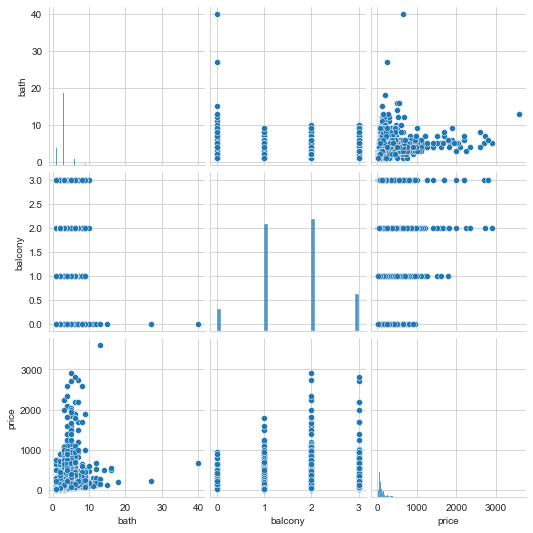

In [7]:
sns.pairplot(df);

In [8]:
def value_count(df):
    for var in df.columns:
        print(df[var].value_counts())
        print("------------------------------------------------------------")

In [9]:
value_count(df)

Super built-up  Area    8790
Built-up  Area          2418
Plot  Area              2025
Carpet  Area              87
Name: area_type, dtype: int64
------------------------------------------------------------
Ready To Move    10581
18-Dec             307
18-May             295
18-Apr             271
18-Aug             200
                 ...  
17-Jan               1
16-Oct               1
15-Jun               1
16-Nov               1
15-Dec               1
Name: availability, Length: 81, dtype: int64
------------------------------------------------------------
Whitefield               540
Sarjapur  Road           399
Electronic City          302
Kanakpura Road           273
Thanisandra              234
                        ... 
manyata tech park          1
2nd Block Hbr Layout       1
Popular Colony             1
7th Block Koramangala      1
T G extension              1
Name: location, Length: 1305, dtype: int64
------------------------------------------------------------
2 BHK      

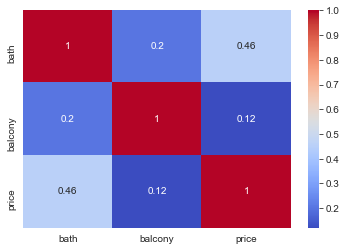

In [10]:
num_vars = ['bath', 'balcony', 'price']
sns.heatmap(df[num_vars].corr(), cmap='coolwarm', annot=True);

## Preare Data for Machine Learning Model

### Data Cleaning

In [11]:
# Sum of Null Values

df.isnull().sum()

area_type          0
availability       0
location           1
size              16
society         5502
total_sqft         0
bath              73
balcony          609
price              0
dtype: int64

In [12]:
# Percentage of Null values

df.isnull().mean() * 100

area_type        0.000000
availability     0.000000
location         0.007508
size             0.120120
society         41.306306
total_sqft       0.000000
bath             0.548048
balcony          4.572072
price            0.000000
dtype: float64

#### *** 'society' column has 41% null values, it's huge, so it's better to drop it.

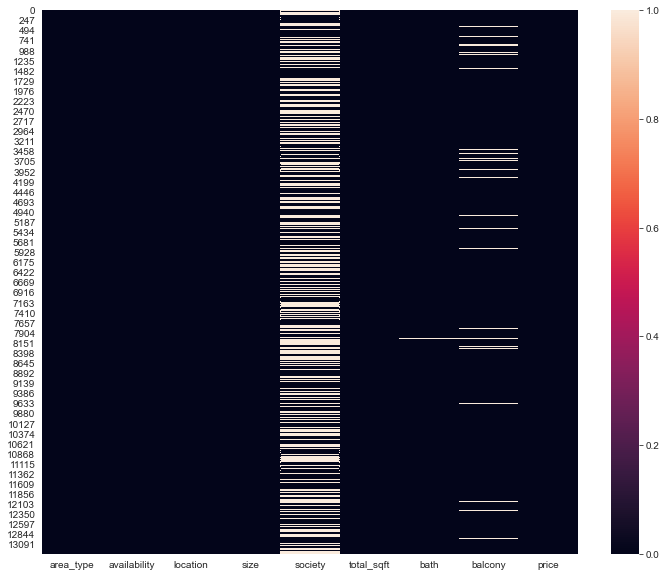

In [13]:
plt.figure(figsize= (12, 10))
sns.heatmap(df.isnull());

In [14]:
# Drop 'society' column

df2 = df.drop('society', axis='columns')
df2.shape

(13320, 8)

In [15]:
# Fill null value in balcony by mean of values

df2['balcony'] = df2['balcony'].fillna(df2['balcony'].mean())
df2.isnull().sum()

area_type        0
availability     0
location         1
size            16
total_sqft       0
bath            73
balcony          0
price            0
dtype: int64

In [16]:
# Remaining null values are less, so we will drop those rows from dataframe.

df3 = df2.dropna()
df3.shape

(13246, 8)

In [17]:
df3.isnull().sum()

area_type       0
availability    0
location        0
size            0
total_sqft      0
bath            0
balcony         0
price           0
dtype: int64

In [18]:
df3.sample(10)

,area_type,availability,location,size,total_sqft,bath,balcony,price
279,Super built-up Area,Ready To Move,Jigani,3 BHK,1252,3.0,3.0,55.0
3254,Built-up Area,Ready To Move,Akshaya Nagar,2 BHK,1280,2.0,1.0,60.0
7513,Built-up Area,Ready To Move,Begur,3 Bedroom,3500,4.0,2.0,185.0
12297,Super built-up Area,18-May,Old Madras Road,2 BHK,1165,2.0,1.0,52.0
9744,Super built-up Area,Ready To Move,Ramamurthy Nagar Extension,3 BHK,1540,3.0,2.0,65.0
8992,Built-up Area,Ready To Move,Queens Road,3 BHK,1405,3.0,0.0,169.0
504,Built-up Area,Ready To Move,Shampura,1 BHK,375,2.0,0.0,26.0
4235,Super built-up Area,Ready To Move,Akshaya Nagar,3 BHK,1430,2.0,2.0,75.0
8060,Super built-up Area,Ready To Move,Bilal Nagar,2 BHK,650,1.0,1.0,20.0
12414,Plot Area,Ready To Move,Hoskote,4 Bedroom,1200,4.0,2.0,100.0


## Feature Engineering

In [19]:
# To show all columns & rows

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

### Converting 'total_sqft', categorical feature to numeric.

In [20]:
df3['total_sqft'].value_counts()

1200                 843
1100                 221
1500                 204
2400                 195
600                  180
1000                 172
1350                 132
1050                 123
1300                 117
1250                 114
900                  112
1400                 108
1800                 104
1150                 101
1600                 100
1140                  91
2000                  82
1450                  70
1650                  69
800                   67
3000                  66
1075                  66
1020                  63
2500                  62
1125                  60
1160                  60
1550                  60
950                   59
1700                  58
1180                  58
1260                  57
1255                  56
1080                  55
1220                  55
1070                  53
750                   52
700                   52
1225                  48
1175                  48
4000                  48


In [21]:
# Convert 'total_sqft' to int 

total_sqft_int = []
for str_val in df3['total_sqft']:
    try:  
        total_sqft_int.append(float(str_val)) # if '123.4' like this value in str then conver in float
    except:
        try:
            temp = []
            temp = str_val.split('-')
            total_sqft_int.append((float(temp[0])+float(temp[-1]))/2) 
            # '123 - 534' this str value split and take mean
        except:
            total_sqft_int.append(np.nan) # if value not contain in above format then consider as nan

In [22]:
# reset the index of dataframe
# drop=True - don't add index column in df
df4 = df3.reset_index(drop=True)

In [23]:
# join df4 and total_srft_int list

df5 = df4.join(pd.DataFrame({'total_sqft_int':total_sqft_int}))
df5.head()

,area_type,availability,location,size,total_sqft,bath,balcony,price,total_sqft_int
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,1056,2.0,1.0,39.07,1056.0
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,2600,5.0,3.0,120.00,2600.0
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,1440,2.0,3.0,62.00,1440.0
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,1521,3.0,1.0,95.00,1521.0
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,1200,2.0,1.0,51.00,1200.0


In [24]:
df5.isnull().sum()

area_type          0
availability       0
location           0
size               0
total_sqft         0
bath               0
balcony            0
price              0
total_sqft_int    46
dtype: int64

In [25]:
# drop NA value

df6 = df5.dropna()
df6.shape

(13200, 9)

In [26]:
df6.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13200 entries, 0 to 13245
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   area_type       13200 non-null  object 
 1   availability    13200 non-null  object 
 2   location        13200 non-null  object 
 3   size            13200 non-null  object 
 4   total_sqft      13200 non-null  object 
 5   bath            13200 non-null  float64
 6   balcony         13200 non-null  float64
 7   price           13200 non-null  float64
 8   total_sqft_int  13200 non-null  float64
dtypes: float64(4), object(5)
memory usage: 1.0+ MB


### Working on <<<< Size >>>> feature

In [27]:
df6['size'].value_counts()

2 BHK         5192
3 BHK         4277
4 Bedroom      816
4 BHK          574
3 Bedroom      541
1 BHK          527
2 Bedroom      325
5 Bedroom      293
6 Bedroom      190
1 Bedroom      100
8 Bedroom       83
7 Bedroom       83
5 BHK           56
9 Bedroom       45
6 BHK           30
7 BHK           17
1 RK            13
10 Bedroom      12
9 BHK            7
8 BHK            5
11 Bedroom       2
10 BHK           2
11 BHK           2
27 BHK           1
13 BHK           1
14 BHK           1
12 Bedroom       1
19 BHK           1
18 Bedroom       1
43 Bedroom       1
16 BHK           1
Name: size, dtype: int64

In [28]:
"""
in  size feature we assume that 
2 BHK = 2 Bedroom = 2 RK
so takes only number and remove sufix text
"""

size_int = []
for str_val in df6['size']:
    temp = []
    temp = str_val.split(" ")
    try:
        size_int.append(int(temp[0]))
    except:
        size_int.append(np.nan)

In [29]:
df6 = df6.reset_index(drop=True)

In [30]:
# join df6 and list_size_int

df7 = df6.join(pd.DataFrame({'bhk':size_int}))
df7.sample(5)

,area_type,availability,location,size,total_sqft,bath,balcony,price,total_sqft_int,bhk
1536,Super built-up Area,Ready To Move,Raja Rajeshwari Nagar,2 BHK,1128,2.0,2.0,38.24,1128.0,2
7411,Super built-up Area,18-May,Bommasandra,3 BHK,1280,3.0,1.0,50.00,1280.0,3
5154,Super built-up Area,Ready To Move,Basapura,3 BHK,1540,2.0,2.0,70.00,1540.0,3
3790,Super built-up Area,Ready To Move,Vijaya Bank Colony,3 BHK,1400,2.0,2.0,62.00,1400.0,3
1305,Super built-up Area,Ready To Move,Electronic City,2 BHK,1070,2.0,1.0,56.10,1070.0,2


In [31]:
df7.shape

(13200, 10)

### Finding Outlier and Removing

In [32]:
# function to create histogram, Q-Q plot and boxplot

# for Q-Q plots
import scipy.stats as stats

In [33]:
def diagnostic_plots(df, variable):
    # function takes a dataframe (df) and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 3, 1)
    sns.histplot(df[variable], bins=30, kde=True)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('Variable quantiles')

    # boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')

    plt.show()

*************bath***************


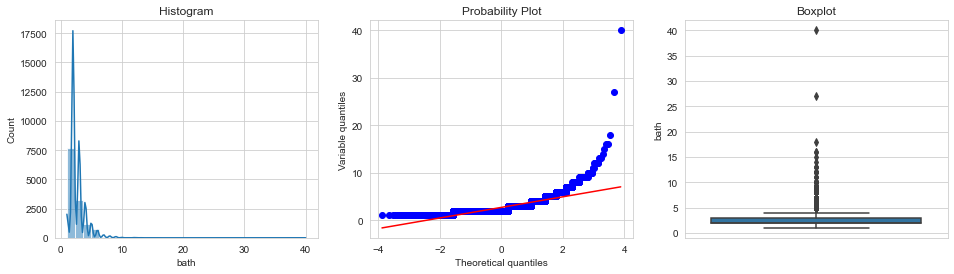

*************balcony***************


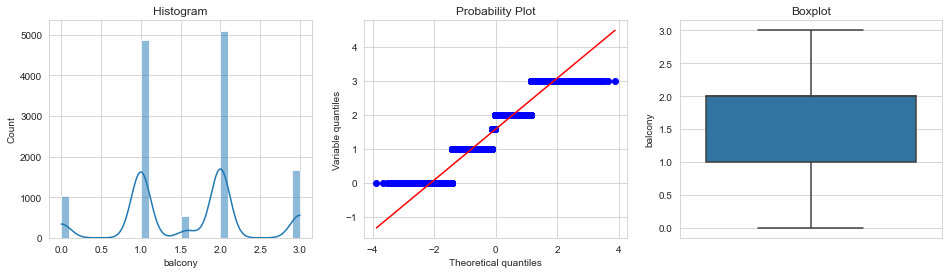

*************price***************


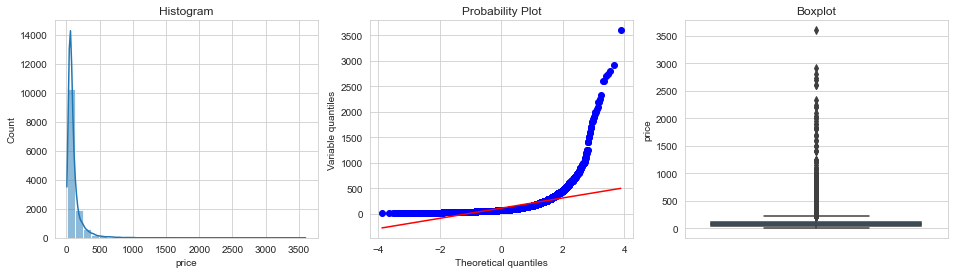

*************total_sqft_int***************


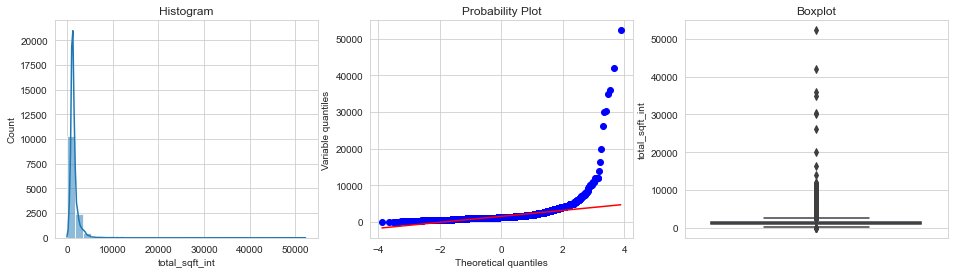

*************bhk***************


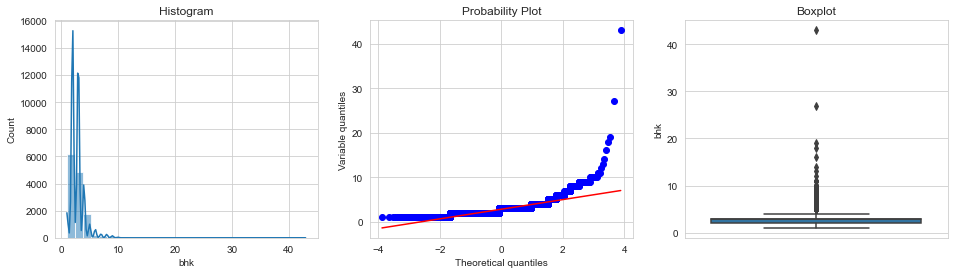

In [34]:
num_var = ['bath', 'balcony', 'price', 'total_sqft_int', 'bhk']

for var in num_var:
    print("*************{}***************".format(var))
    diagnostic_plots(df7, var)

In [35]:
# here we consider  1 BHK requierd min 350 sqft are

df7[df7['total_sqft_int'] / df7['bhk'] < 350].head()

,area_type,availability,location,size,total_sqft,bath,balcony,price,total_sqft_int,bhk
9,Plot Area,Ready To Move,Gandhi Bazar,6 Bedroom,1020,6.0,1.584376,370.0,1020.0,6
26,Super built-up Area,Ready To Move,Electronic City,2 BHK,660,1.0,1.000000,23.1,660.0,2
29,Super built-up Area,Ready To Move,Electronic City,3 BHK,1025,2.0,1.000000,47.0,1025.0,3
45,Plot Area,Ready To Move,HSR Layout,8 Bedroom,600,9.0,1.584376,200.0,600.0,8
57,Plot Area,Ready To Move,Murugeshpalya,6 Bedroom,1407,4.0,1.000000,150.0,1407.0,6


In [36]:
df8 = df7[~(df7['total_sqft_int'] / df7['bhk'] < 350)]
df8.shape

(12106, 10)

In [37]:
# create new feature that is price per squre foot 
# it help to find the outliers
# price in lakh so convert into rupee and then / by total_sqft_int

df8['price_per_sqft'] = df8['price'] * 100000 / df8['total_sqft_int']
df8.head()

C:\Users\akash\AppData\Local\Temp/ipykernel_8172/3784022103.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df8['price_per_sqft'] = df8['price'] * 100000 / df8['total_sqft_int']


,area_type,availability,location,size,total_sqft,bath,balcony,price,total_sqft_int,bhk,price_per_sqft
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,1056,2.0,1.0,39.07,1056.0,2,3699.810606
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,2600,5.0,3.0,120.00,2600.0,4,4615.384615
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,1440,2.0,3.0,62.00,1440.0,3,4305.555556
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,1521,3.0,1.0,95.00,1521.0,3,6245.890861
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,1200,2.0,1.0,51.00,1200.0,2,4250.000000


In [38]:
df8.price_per_sqft.describe()

#here we can see huge difference between min and max price_per_sqft
# min 6308.502826 max 176470.588235

count     12106.000000
mean       6184.466889
std        4019.983503
min         267.829813
25%        4200.030048
50%        5261.108523
75%        6800.000000
max      176470.588235
Name: price_per_sqft, dtype: float64

In [39]:
# Removing outliers using help of 'price per sqrt'  taking std and mean per location
def remove_pps_outliers(df):
    df_out = pd.DataFrame()
    for key, subdf in df.groupby('location'):
        m = np.mean(subdf.price_per_sqft)
        st = np.std(subdf.price_per_sqft)
        reduced_df = subdf[(subdf.price_per_sqft > (m-st)) & (subdf.price_per_sqft <= (m+st))]
        df_out = pd.concat([df_out, reduced_df], ignore_index=True)
    return df_out

In [40]:
df9 = remove_pps_outliers(df8)
df9.shape

(8888, 11)

In [41]:
def plot_scatter_chart(df,location):
  bhk2 = df[(df.location==location) & (df.bhk==2)]
  bhk3 = df[(df.location==location) & (df.bhk==3)]
  plt.figure(figsize=(16,9))
  plt.scatter(bhk2.total_sqft_int, bhk2.price, color='Blue', label='2 BHK', s=50)
  plt.scatter(bhk3.total_sqft_int, bhk3.price, color='Red', label='3 BHK', s=50, marker="+")
  plt.xlabel("Total Square Feet Area")
  plt.ylabel("Price")
  plt.title(location)
  plt.legend()

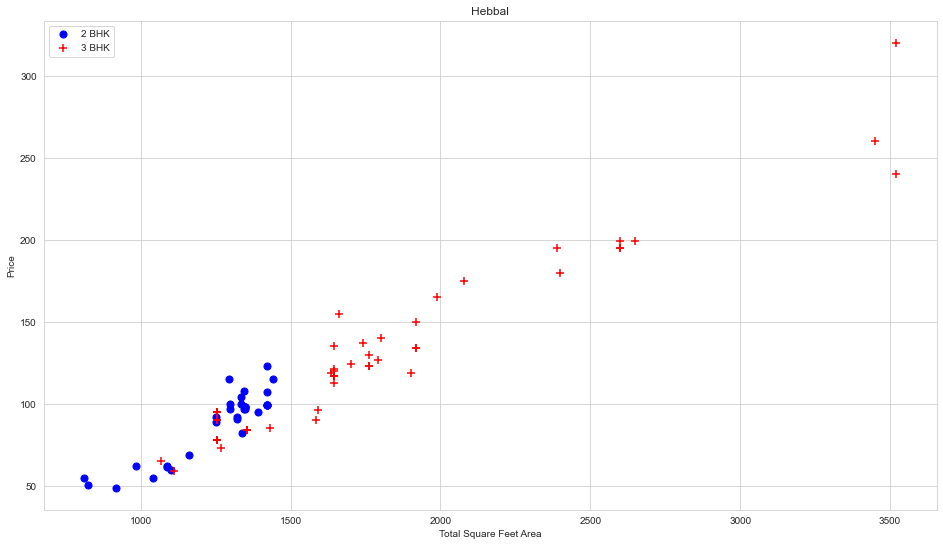

In [42]:
plot_scatter_chart(df9, 'Hebbal')

# in below scatterplot we observe that at same location price of
# 2 bhk house is greater than 3 bhk so it is outlier

In [43]:
# removing bhk outliers

def remove_bhk_outliers(df):
    exclude_indices = np.array([])
    for location, location_df in df.groupby('location'):
        bhk_stats = {}
        for bhk, bhk_df in location_df.groupby('bhk'):
            bhk_stats[bhk] = {
                'mean':np.mean(bhk_df.price_per_sqft),
                'std':np.std(bhk_df.price_per_sqft),
                'count':bhk_df.shape[0]
            }
        for bhk, bhk_df in location_df.groupby('bhk'):
            stats=bhk_stats.get(bhk-1)
            if stats and stats['count']>5:
                exclude_indices = np.append(exclude_indices, bhk_df[bhk_df.price_per_sqft<(stats['mean'])].index.values)
    return df.drop(exclude_indices, axis='index')   

In [44]:
df10 = remove_bhk_outliers(df9)
df10.shape

(7194, 11)

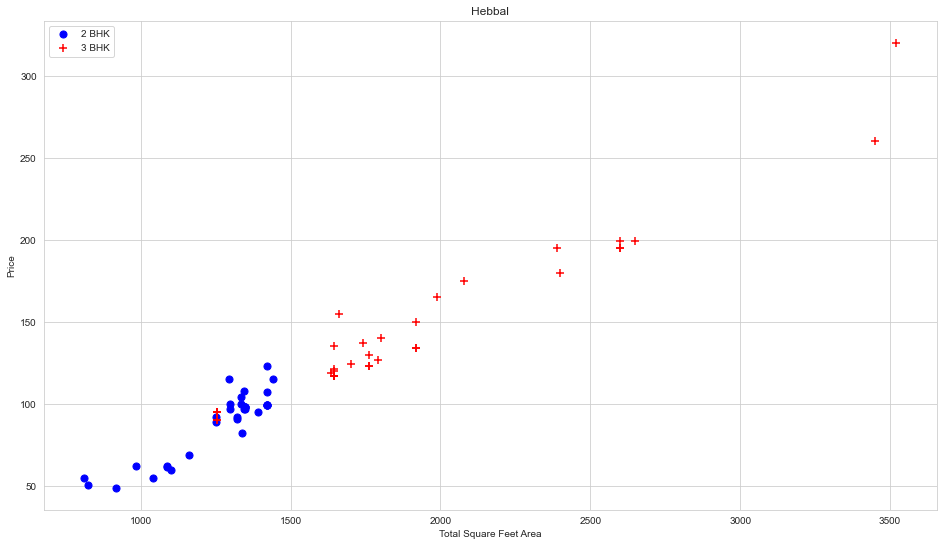

In [45]:
plot_scatter_chart(df10, "Hebbal")

# In below scatter plot most of the red data point remove fron blue points

### Remove outliers using the help of 'bath' feature

In [46]:
df10.bath.unique()

array([ 3.,  2.,  1.,  4.,  5.,  8.,  9.,  6.,  7., 12.])

In [47]:
df10[df10.bath > df10.bhk + 2]

,area_type,availability,location,size,total_sqft,bath,balcony,price,total_sqft_int,bhk,price_per_sqft
1861,Built-up Area,Ready To Move,Chikkabanavar,4 Bedroom,2460,7.0,2.000000,80.0,2460.0,4,3252.032520
5836,Built-up Area,Ready To Move,Nagasandra,4 Bedroom,7000,8.0,1.584376,450.0,7000.0,4,6428.571429
7098,Super built-up Area,Ready To Move,Sathya Sai Layout,6 BHK,11338,9.0,1.000000,1000.0,11338.0,6,8819.897689
7569,Super built-up Area,Ready To Move,Thanisandra,3 BHK,1806,6.0,2.000000,116.0,1806.0,3,6423.034330


In [48]:
# here we are considering data only total no. bathroom =  bhk + 1
df11 = df10[df10.bath < df10.bhk+2]
df11.shape

(7120, 11)

In [49]:
df11.sample(5)

,area_type,availability,location,size,total_sqft,bath,balcony,price,total_sqft_int,bhk,price_per_sqft
7716,Built-up Area,Ready To Move,Upkar Layout,1 Bedroom,1050,1.0,1.0,70.00,1050.0,1,6666.666667
1481,Super built-up Area,Ready To Move,Bisuvanahalli,3 BHK,1075,2.0,1.0,45.00,1075.0,3,4186.046512
4517,Super built-up Area,Ready To Move,Kanakpura Road,3 BHK,1665,3.0,2.0,86.58,1665.0,3,5200.000000
366,Plot Area,Ready To Move,Agrahara Dasarahalli,3 Bedroom,1350,1.0,0.0,120.00,1350.0,3,8888.888889
3081,Super built-up Area,18-Mar,Haralur Road,2 BHK,1225,2.0,1.0,77.00,1225.0,2,6285.714286


In [50]:
df12 = df11.drop(['area_type', 'availability', 'location', 'size', 'total_sqft'], axis=1)
df12.head()

,bath,balcony,price,total_sqft_int,bhk,price_per_sqft
0,3.0,2.0,150.0,1672.0,3,8971.291866
1,3.0,3.0,149.0,1750.0,3,8514.285714
2,3.0,2.0,150.0,1750.0,3,8571.428571
4,2.0,2.0,40.0,1250.0,2,3200.000000
5,2.0,2.0,83.0,1200.0,2,6916.666667


In [51]:
df12.to_csv("clean_data.csv", index=False) # test ml model on this data

## Categorical Variable Encoding

In [52]:
df13 = df11.drop(['size', 'total_sqft'], axis=1)
df13.head()

,area_type,availability,location,bath,balcony,price,total_sqft_int,bhk,price_per_sqft
0,Super built-up Area,Ready To Move,Devarabeesana Halli,3.0,2.0,150.0,1672.0,3,8971.291866
1,Built-up Area,Ready To Move,Devarabeesana Halli,3.0,3.0,149.0,1750.0,3,8514.285714
2,Super built-up Area,Ready To Move,Devarabeesana Halli,3.0,2.0,150.0,1750.0,3,8571.428571
4,Super built-up Area,Ready To Move,Devarachikkanahalli,2.0,2.0,40.0,1250.0,2,3200.000000
5,Plot Area,Ready To Move,Devarachikkanahalli,2.0,2.0,83.0,1200.0,2,6916.666667


In [53]:
df14 = pd.get_dummies(df13, drop_first=True, columns=['area_type','availability','location'])
df14.head()

,bath,balcony,price,total_sqft_int,bhk,price_per_sqft,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,availability_15-Jun,availability_15-Nov,availability_15-Oct,availability_16-Dec,availability_16-Jul,availability_16-Mar,availability_16-Nov,availability_16-Oct,availability_16-Sep,availability_17-Apr,availability_17-Aug,availability_17-Dec,availability_17-Jan,availability_17-Jul,availability_17-Jun,availability_17-Mar,availability_17-May,availability_17-Nov,availability_17-Oct,availability_17-Sep,availability_18-Apr,availability_18-Aug,availability_18-Dec,availability_18-Feb,availability_18-Jan,availability_18-Jul,availability_18-Jun,availability_18-Mar,availability_18-May,availability_18-Nov,availability_18-Oct,availability_18-Sep,availability_19-Apr,availability_19-Aug,availability_19-Dec,availability_19-Feb,availability_19-Jan,availability_19-Jul,availability_19-Jun,availability_19-Mar,availability_19-May,availability_19-Oct,availability_19-Sep,availability_20-Apr,availability_20-Aug,availability_20-Dec,availability_20-Jan,availability_20-Jun,availability_20-Mar,availability_20-May,availability_20-Nov,availability_20-Oct,availability_20-Sep,availability_21-Dec,availability_21-Feb,availability_21-Jan,availability_21-Jul,availability_21-Jun,availability_21-Mar,availability_21-May,availability_21-Nov,availability_21-Oct,availability_21-Sep,availability_22-Dec,availability_22-Jan,availability_22-Jun,availability_22-Mar,availability_22-May,availability_22-Nov,availability_Ready To Move,location_ Devarachikkanahalli,location_ Electronic City,location_ Mysore Highway,location_ Rachenahalli,location_ Thanisandra,location_ south,location_1st Block BEL Layout,location_1st Block HBR Layout,location_1st Block HRBR Layout,location_1st Block Jayanagar,location_1st Block Koramangala,location_1st Phase JP Nagar,location_1st Stage Indira Nagar,location_2nd Block Hrbr Layout,location_2nd Block Jayanagar,location_2nd Phase JP Nagar,location_2nd Phase Judicial Layout,location_2nd Stage Nagarbhavi,location_3rd Block Banashankari,location_3rd Block Hrbr Layout,location_3rd Block Jayanagar,location_3rd Block Koramangala,location_3rd Phase JP Nagar,location_4th Block Jayanagar,location_4th Block Koramangala,location_4th Phase JP Nagar,location_4th T block Jayanagar,location_5th Block Hbr Layout,location_5th Phase JP Nagar,location_6th Phase JP Nagar,location_6th block Koramangala,location_7th Block Jayanagar,location_7th Phase JP Nagar,location_8th Block Jayanagar,location_8th Phase JP Nagar,location_8th block Koramangala,location_9th Block Jayanagar,location_9th Phase JP Nagar,location_A Narayanapura,location_AECS Layout,location_AGS Layout,location_AMS Layout,location_Abbaiah Reddy Layout,location_Abbigere,location_Agrahara Dasarahalli,location_Aishwarya Crystal Layout,location_Akshaya Nagar,location_Akshaya Vana,location_Akshayanagara East,location_Akshya Nagar,location_Alfa Garden Layout,location_Alur,location_Amarjyothi Colony,location_Ambalipura,location_Ambedkar Colony,location_Ambedkar Nagar,location_Amblipura,location_Amruthahalli,location_Amruthnagar,location_Anand Nagar,location_Anand nagar,location_Anandapura,location_Anantapura,location_Ananth Nagar,location_Anekal,location_Anjanapura,location_Anjappa Layout,location_Ankappa Layout,location_Annaiah Reddy Layout,location_Anugrah Layout,location_Anwar Layout,location_Ardendale,location_Arehalli,location_Arekere,location_Ashirvad Colony,location_Ashok Nagar,location_Ashwath Nagar,location_Ashwathnagar,location_Ashwini layout,location_Atmananda Colony,location_Attibele,location_Attur Layout,location_Austin Town,location_Avalahalli,location_Ayappa Nagar,location_B Channasandra,location_B Narayanapura,location_BCC Layout,location_BCMC Layout,location_BEL Road,location_BEML Layout,location_BSM Extension,location_BTM 1st Stage,location_BTM 2nd Stage,location_BTM 4th Stage,location_BTM Layout,location_Baba Nagar,location_Babusapalaya,location_Badavala Nagar,location_Bag

In [54]:
df14.shape

(7120, 820)

In [55]:
df14.to_csv('oh_encoded_data.csv', index=False) # test ml model on this data

In 'area_type','availability','location' contain multiple classe and if we convert them into OHE so it increase the size of DF so try to use those classes which are frequently present in the cat var

In [56]:
df15 = df13.copy()

In [57]:
df16 = df15.drop(['area_type','availability','location'], axis=1)

In [58]:
df16.sample(3)

,bath,balcony,price,total_sqft_int,bhk,price_per_sqft
8224,5.0,0.0,290.00,3250.0,5,8923.076923
1007,2.0,2.0,65.26,1255.0,2,5200.000000
7957,1.0,1.0,42.00,596.0,1,7046.979866


In [59]:
df16.to_csv('data_reduce_for_ml.csv', index=False) 